Load model first: requires to change "model_path" variable

In [1]:
import torch
import numpy as np
from ultralytics import YOLO

model_path = "./best.pt"
model = YOLO(model_path)

Extract the ground truth from the DeepLabCut CSV. Requires to change "validation_set_path" and "csv_file_name" variables


In [25]:
import pandas as pd

validation_set_images_path = "thorax_dataset/images/test"
csv_file_name = "new_annotations.csv"
df = pd.read_csv(csv_file_name)
image_file_names = df.iloc[:, 0]
df = df.iloc[:, 1:]
df.head()

,x1_lmk,y1_lmk,x2_lmk,y2_lmk
0,190.603985,199.479713,407.313962,328.349297
1,175.484684,109.914697,397.234428,170.986006
2,174.224742,117.000933,384.635011,197.457880
3,137.686432,91.142189,388.414836,215.302585
4,107.447831,71.837948,287.619498,114.624509


In [26]:
ground_truth = df.to_numpy()
ground_truth

array([[      190.6,      199.48,      407.31,      328.35],
       [     175.48,      109.91,      397.23,      170.99],
       [     174.22,         117,      384.64,      197.46],
       ...,
       [     129.02,      102.92,      396.34,      248.03],
       [     264.35,       178.5,      489.26,      235.76],
       [     160.46,      199.08,      339.42,      264.81]])

Predict the landmarks locations

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

ground_truth = df.to_numpy()
# Nx4 Matrix to store the landmarks coordinates (each rows are [x_head, y_head, x_abdomen, y_abdomen])
prediction_data = np.zeros(ground_truth.shape)

# Vector that contains 1 and 0 for ants images with detected and not detected landkmarks respectivelly 
is_detected_data = np.ones(len(image_file_names))

count = 0
for file_name in image_file_names:
    path = validation_set_images_path + file_name

    results = model.predict(path)
    shape = results[0].keypoints.shape
    if shape[1] == 0:
        is_detected_data[count] = 0
    else:
        point1_pred = results[0].keypoints.xy[0][0].numpy()
        point2_pred = results[0].keypoints.xy[0][1].numpy()
        
        prediction_data[count,0:2] = point1_pred
        prediction_data[count,2:] = point2_pred

    count = count + 1
    

FileNotFoundError: thorax_dataset/images/trainanic32-900190-1_p_1.jpg does not exist

Compute metrics


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01128010_p_1.jpg: 480x640 1 thorax, 465.7ms
Speed: 26.4ms preprocess, 465.7ms inference, 22.1ms postprocess per image at shape (1, 3, 480, 640)


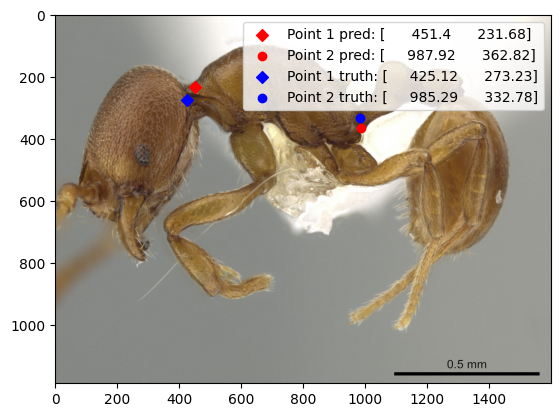

example landmark ant usnment01128010_p_1.jpg
prediction:
[      451.4      231.68      987.92      362.82]
ground truth:
[     425.12      273.23      985.29      332.78]
difference:
[     26.288     -41.551      2.6358      30.036]
percentage of error Webber length:
0.03402308857840439

Average distance between predicted and true head landmark:
30.645619237373246
Av distance(norm by WL) between predicted and true head landmark:
0.07025506054120693

Average distance between predicted and true abdomen landmark:
29.897633543473102
Av distance(norm by WL) between predicted and true abdomen landmark:
0.07280029727333194

average signed bias (pred-GT) of coordinates:
(x_head, y_head, x_abdomen, y_abdomean)
[     -4.442     -20.067     -9.7935      18.215]
average absolute bias of coordinates (x_head, y_head, x_abdomen, y_abdomean)
[     14.632       23.26      16.113       21.38]


In [ ]:
def show_image_and_landmarks(count, path, prediction_data, ground_truth):
    results = model.predict(path)
    shape = results[0].keypoints.shape
    
    img = mpimg.imread(path)

    plt.imshow(img)
    plt.axis('on')  # Turn on axes for reference

    point1_pred = prediction_data[count,0:2]
    point2_pred = prediction_data[count,2:]

    point1_ground_thruth = ground_truth[count,0:2]
    point2_ground_thruth = ground_truth[count,2:]

    # Plot the points

    plt.scatter(*point1_pred, color='red', marker='D',label=f'Point 1 pred: {point1_pred}')
    plt.scatter(*point2_pred, color='red', label=f'Point 2 pred: {point2_pred}')

    plt.scatter(*point1_ground_thruth, color='blue', marker='D',label=f'Point 1 truth: {point1_ground_thruth}')
    plt.scatter(*point2_ground_thruth, color='blue', label=f'Point 2 truth: {point2_ground_thruth}')

    # Add legend
    plt.legend()

    # Show the plot
    plt.show()

def compute_WL(data):
    x1 = data[:,0]
    y1 = data[:,1]

    x2 = data[:,2]
    y2 = data[:,3]

    return ((x1-x2)**2 + (y1-y2)**2)**0.5

pred  = prediction_data[is_detected_data == 1, :]
GT  = ground_truth[is_detected_data == 1, :]

#Matrix that contains the difference (in pixel) between the predicted and ground truth landmark
difference_landmarks = pred-GT

i = 1
show_image_and_landmarks(i, validation_set_images_path+str(image_file_names[i]), prediction_data, ground_truth)


print("example landmark ant " + str(image_file_names[i]))
print("prediction:")
print(prediction_data[i,:])
print("ground truth:")
print(GT[i,:])
print("difference:")
d = prediction_data-ground_truth
print(d[i,:])


# Webber length
WL_pred =  compute_WL(pred)
WL_GT =  compute_WL(GT)

percentage_error = abs(WL_GT-WL_pred)/WL_GT
print("percentage of error Webber length:")
print(np.mean(percentage_error))

head_dist_pred_GT = ((difference_landmarks[:,0])**2 + (difference_landmarks[:,1])**2)**0.5
abdomen_dist_pred_GT = ((difference_landmarks[:,3])**2 + (difference_landmarks[:,0])**2)**0.5
print("")
print("Average distance between predicted and true head landmark:")
print(np.mean(head_dist_pred_GT))
print("Av distance(normalized by WL) between predicted and true head landmark:")
print(np.mean(abdomen_dist_pred_GT/WL_GT))
print("")

print("Average distance between predicted and true abdomen landmark:")
print(np.mean(abdomen_dist_pred_GT))
print("Av distance(normalized by WL) between predicted and true abdomen landmark:")
print(np.mean(head_dist_pred_GT/WL_GT))
print("")

print("average signed bias (pred-GT) of coordinates:")
print("(x_head, y_head, x_abdomen, y_abdomean)")
print(np.mean(difference_landmarks, axis=0))



print("average absolute bias of coordinates (x_head, y_head, x_abdomen, y_abdomean)")
print(np.mean(abs(difference_landmarks), axis=0))

Plot results images


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01127990_p_1.jpg: 480x640 1 thorax, 177.2ms
Speed: 53.9ms preprocess, 177.2ms inference, 16.0ms postprocess per image at shape (1, 3, 480, 640)


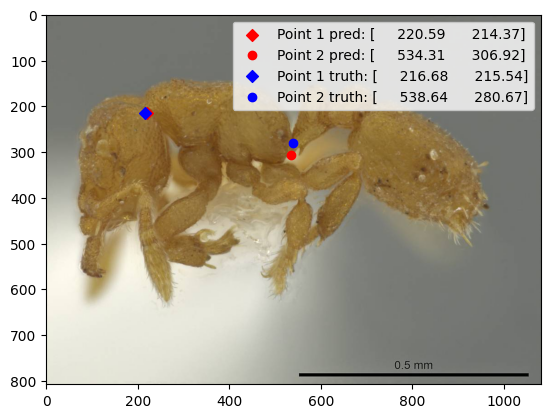


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01128010_p_1.jpg: 480x640 1 thorax, 138.3ms
Speed: 5.4ms preprocess, 138.3ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


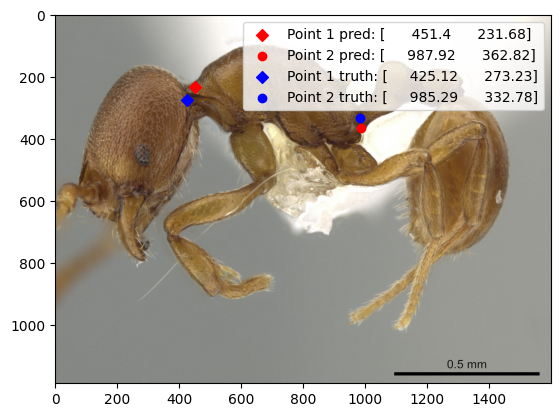


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01128013_p_1.jpg: 480x640 1 thorax, 188.8ms
Speed: 1.6ms preprocess, 188.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


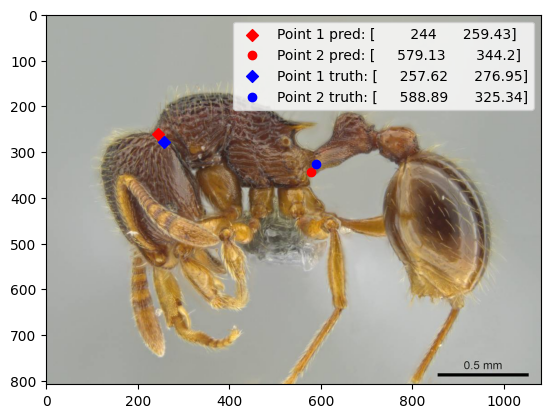


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129587_p_1.jpg: 416x640 2 thoraxs, 156.5ms
Speed: 2.0ms preprocess, 156.5ms inference, 0.4ms postprocess per image at shape (1, 3, 416, 640)


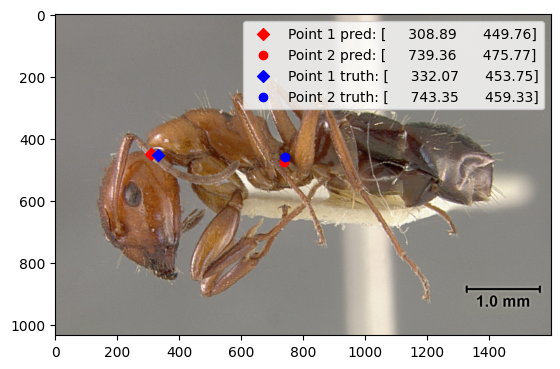


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129588_p_1.jpg: 448x640 1 thorax, 111.1ms
Speed: 2.3ms preprocess, 111.1ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)


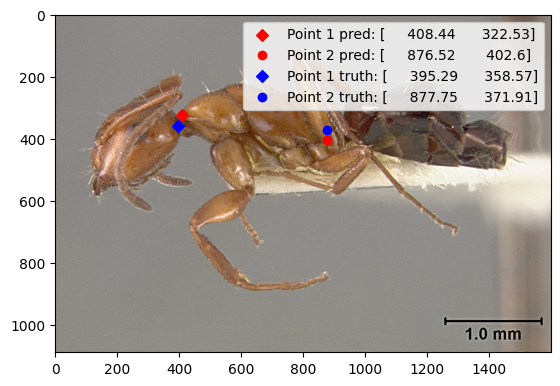


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129592_p_1.jpg: 416x640 1 thorax, 129.7ms
Speed: 2.4ms preprocess, 129.7ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


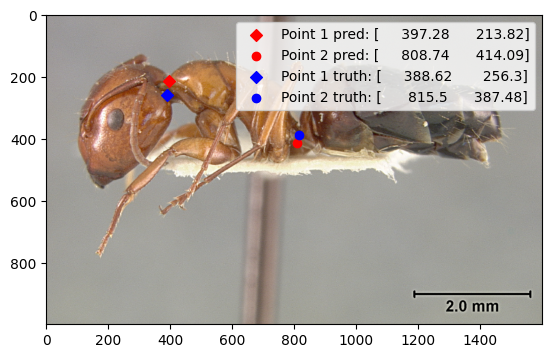


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129597_p_1.jpg: 320x640 1 thorax, 165.2ms
Speed: 1.1ms preprocess, 165.2ms inference, 1.3ms postprocess per image at shape (1, 3, 320, 640)


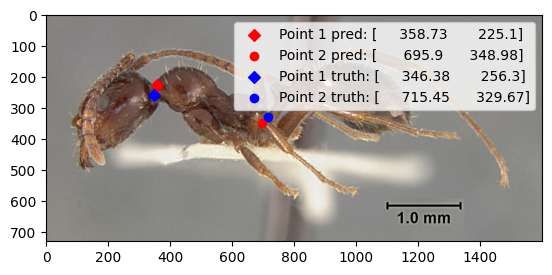


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129598_p_1.jpg: 384x640 1 thorax, 138.0ms
Speed: 1.4ms preprocess, 138.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


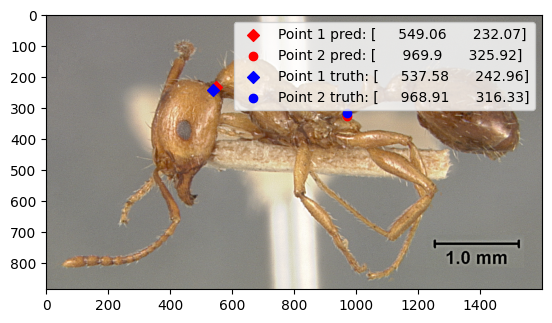


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129601_p_1.jpg: 416x640 1 thorax, 114.4ms
Speed: 1.4ms preprocess, 114.4ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


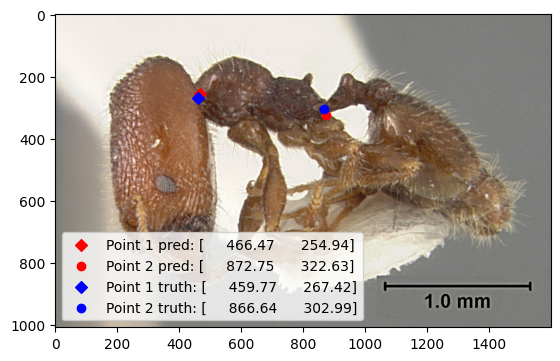


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/usnment01129603_p_1.jpg: 480x640 1 thorax, 144.6ms
Speed: 38.1ms preprocess, 144.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


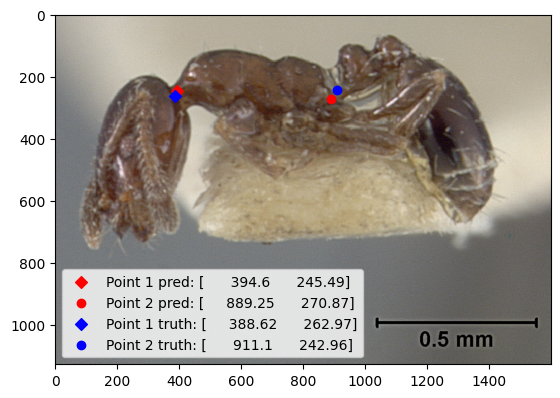


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento11767-01_p_1.jpg: 448x640 1 thorax, 117.9ms
Speed: 1.7ms preprocess, 117.9ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


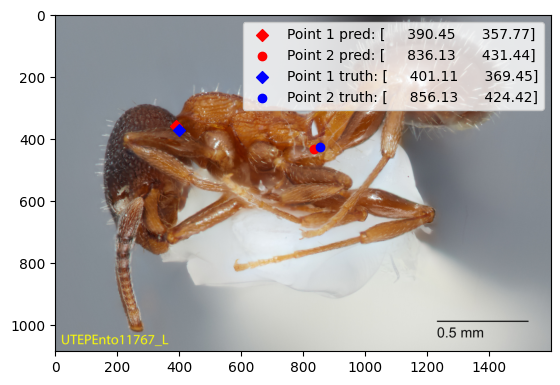


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento218-02_p_1.jpg: 448x640 1 thorax, 134.3ms
Speed: 2.5ms preprocess, 134.3ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)


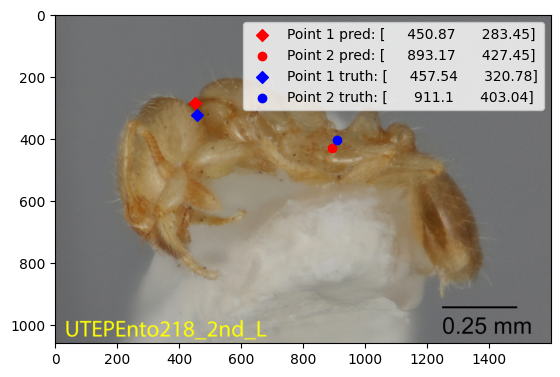


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento25738-02_p_1.jpg: 384x640 1 thorax, 149.1ms
Speed: 1.3ms preprocess, 149.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


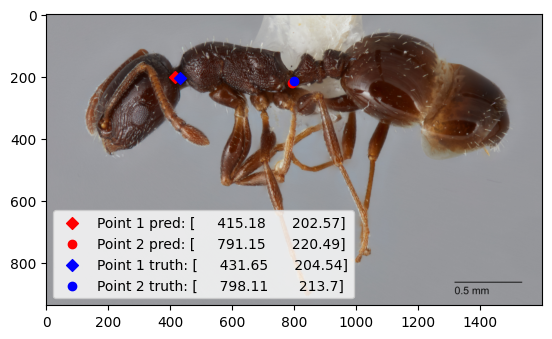


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento26084_p_1.jpg: 480x640 1 thorax, 139.2ms
Speed: 1.6ms preprocess, 139.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


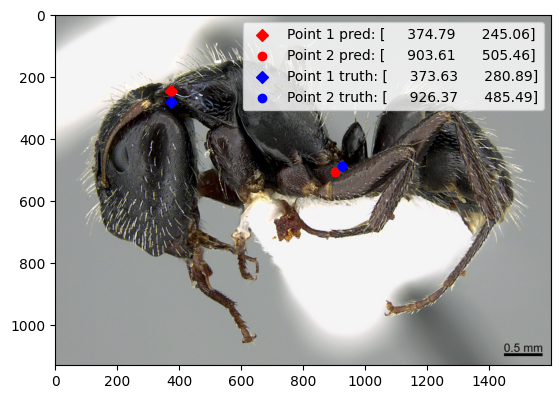


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento26086_p_1.jpg: 512x640 1 thorax, 167.6ms
Speed: 6.4ms preprocess, 167.6ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)


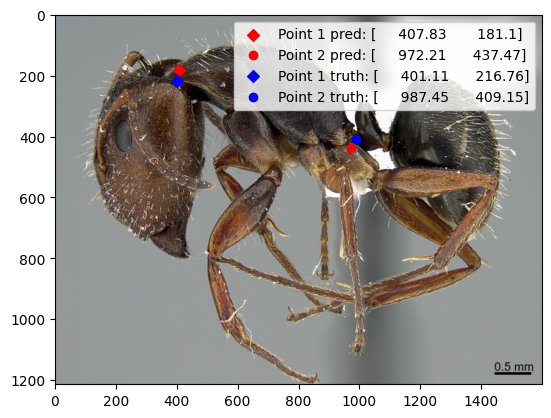


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento3394_p_1.jpg: 384x640 1 thorax, 114.8ms
Speed: 1.3ms preprocess, 114.8ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)


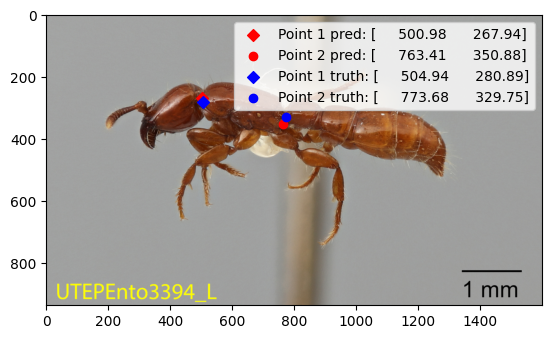


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento3521_p_1.jpg: 448x640 1 thorax, 150.3ms
Speed: 12.9ms preprocess, 150.3ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)


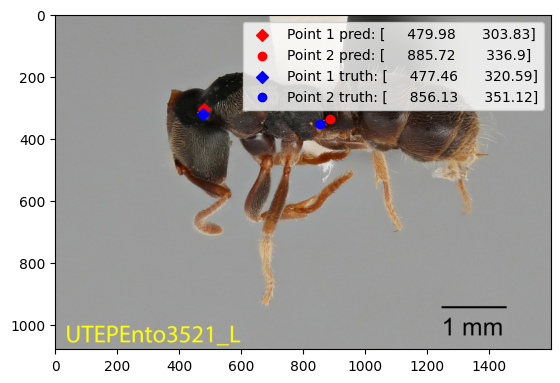


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento3523_p_1.jpg: 512x640 1 thorax, 144.7ms
Speed: 2.6ms preprocess, 144.7ms inference, 0.4ms postprocess per image at shape (1, 3, 512, 640)


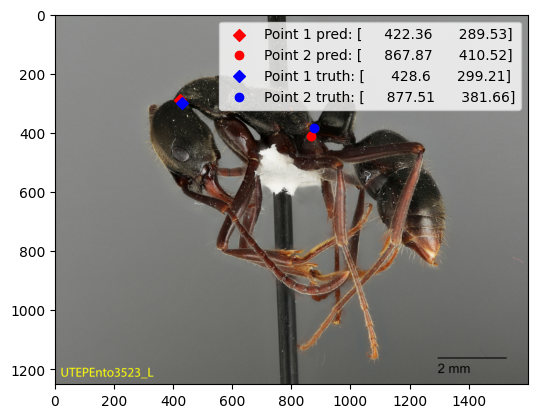


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento3524_p_1.jpg: 544x640 1 thorax, 186.8ms
Speed: 7.7ms preprocess, 186.8ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)


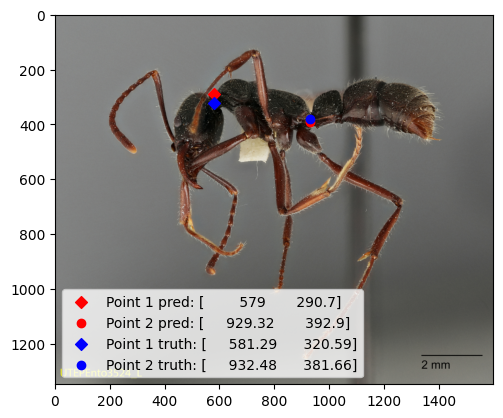


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento3525_p_1.jpg: 480x640 1 thorax, 115.0ms
Speed: 2.3ms preprocess, 115.0ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


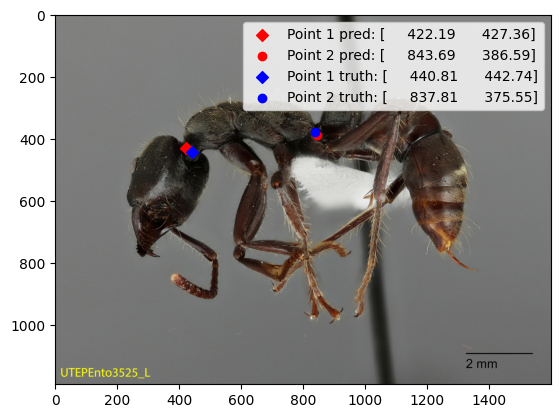


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4466_p_1.jpg: 544x640 (no detections), 166.2ms
Speed: 37.2ms preprocess, 166.2ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)


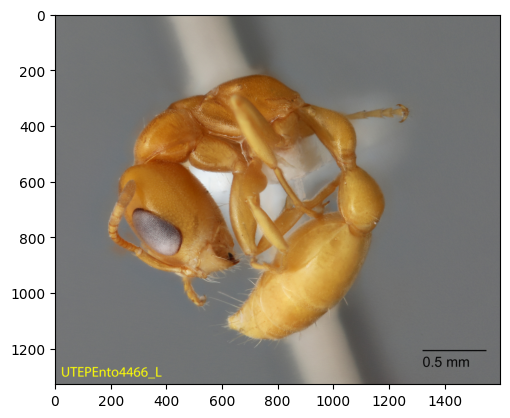


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4468_p_1.jpg: 352x640 1 thorax, 107.7ms
Speed: 1.4ms preprocess, 107.7ms inference, 0.8ms postprocess per image at shape (1, 3, 352, 640)


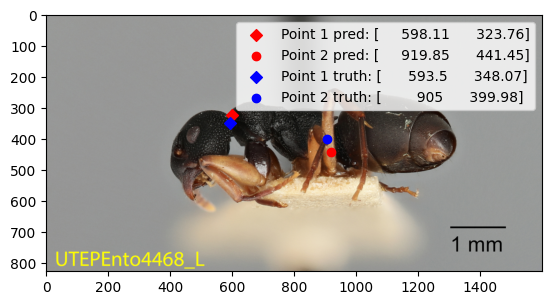


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4469_p_1.jpg: 416x640 1 thorax, 184.0ms
Speed: 1.5ms preprocess, 184.0ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)


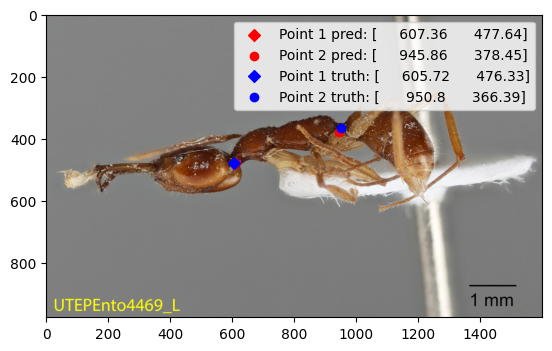


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4472-02_p_1.jpg: 512x640 1 thorax, 148.2ms
Speed: 6.3ms preprocess, 148.2ms inference, 0.3ms postprocess per image at shape (1, 3, 512, 640)


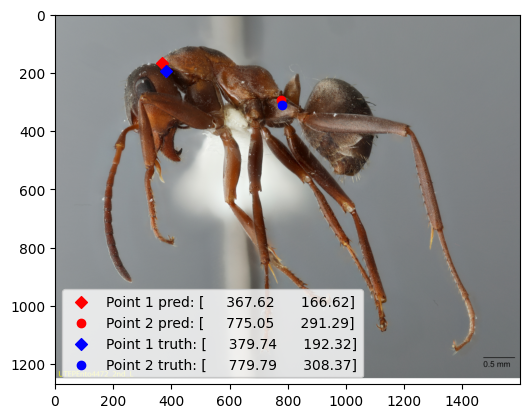


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4473_p_1.jpg: 448x640 (no detections), 224.1ms
Speed: 2.1ms preprocess, 224.1ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


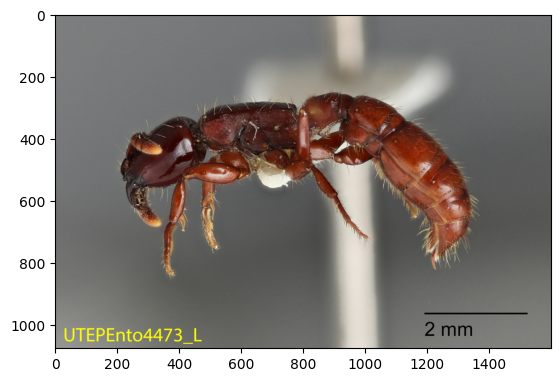


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4474_p_1.jpg: 416x640 1 thorax, 142.6ms
Speed: 1.9ms preprocess, 142.6ms inference, 0.5ms postprocess per image at shape (1, 3, 416, 640)


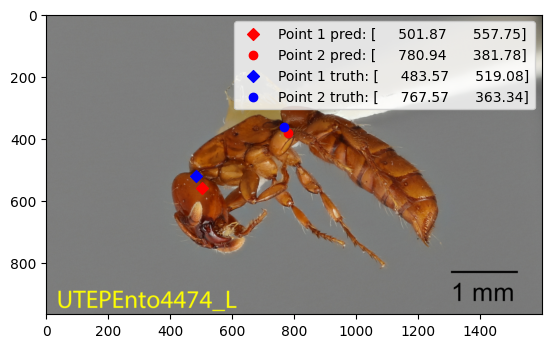


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4478_p_1.jpg: 448x640 1 thorax, 177.9ms
Speed: 1.8ms preprocess, 177.9ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)


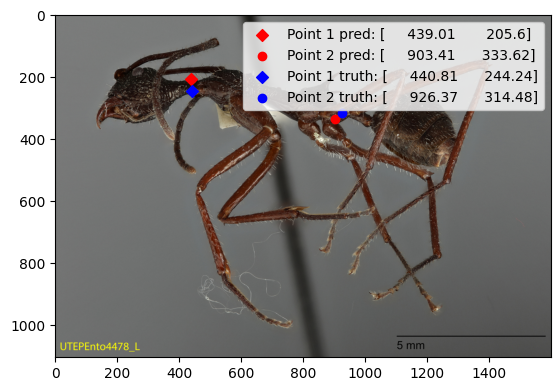


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento4480-01_p_1.jpg: 512x640 1 thorax, 146.2ms
Speed: 1.9ms preprocess, 146.2ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


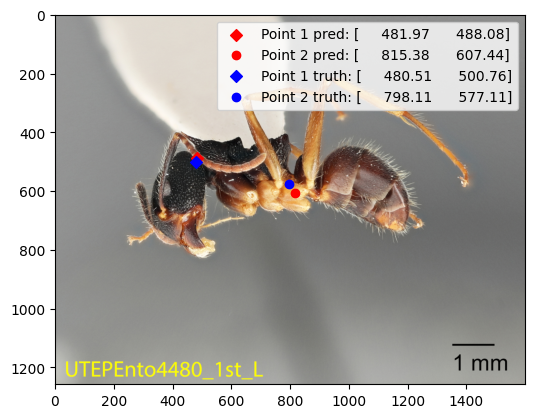


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento5451_p_1.jpg: 416x640 1 thorax, 112.7ms
Speed: 1.7ms preprocess, 112.7ms inference, 0.3ms postprocess per image at shape (1, 3, 416, 640)


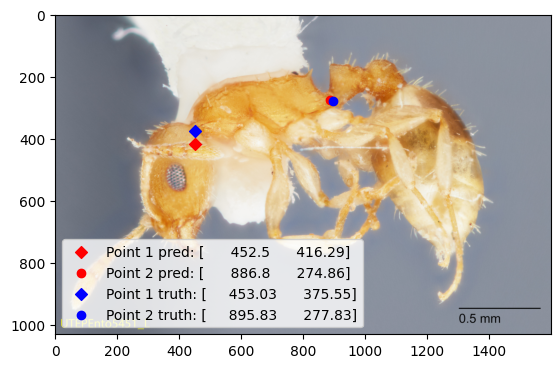


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento60007-01_p_1.jpg: 448x640 1 thorax, 118.9ms
Speed: 1.7ms preprocess, 118.9ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)


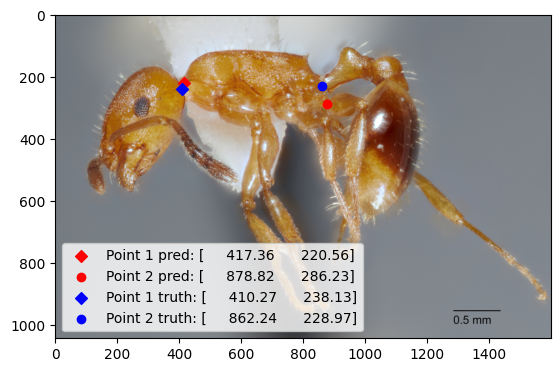


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento60007-02_p_1.jpg: 352x640 1 thorax, 115.6ms
Speed: 1.3ms preprocess, 115.6ms inference, 0.4ms postprocess per image at shape (1, 3, 352, 640)


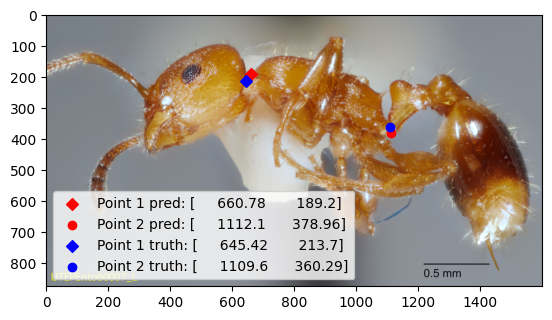


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento60008_p_1.jpg: 576x640 1 thorax, 136.2ms
Speed: 25.5ms preprocess, 136.2ms inference, 0.4ms postprocess per image at shape (1, 3, 576, 640)


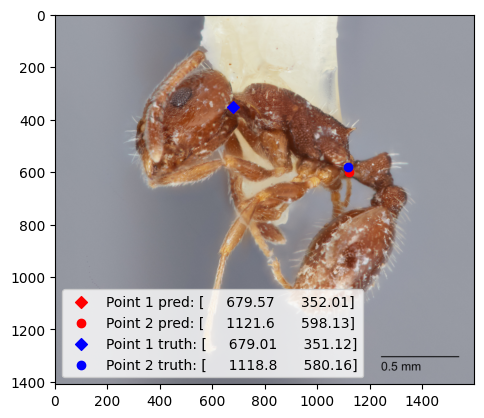


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/utepento6086-03_p_1.jpg: 480x640 1 thorax, 151.6ms
Speed: 1.9ms preprocess, 151.6ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


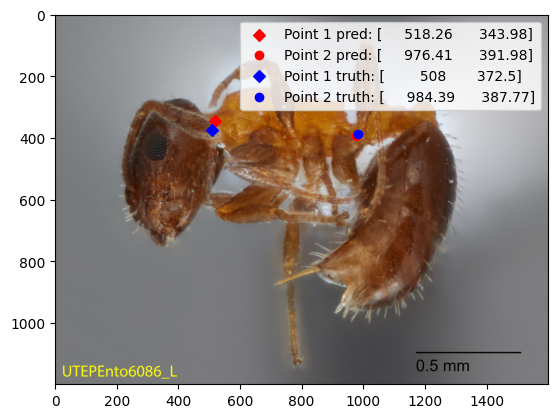


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/xe00201-1_p_1.jpg: 416x640 1 thorax, 135.0ms
Speed: 1.5ms preprocess, 135.0ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 640)


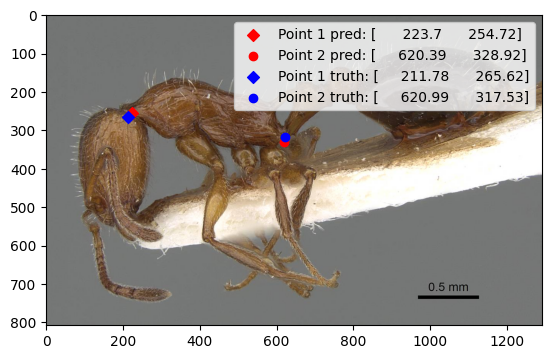


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/xe00205-1_p_1.jpg: 480x640 1 thorax, 144.1ms
Speed: 2.2ms preprocess, 144.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


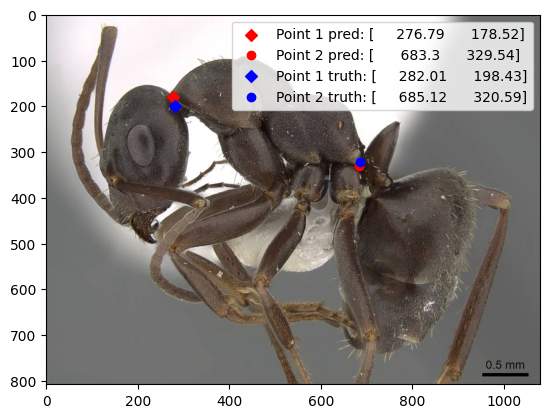


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20093102_p_1.jpg: 448x640 1 thorax, 170.9ms
Speed: 1.4ms preprocess, 170.9ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)


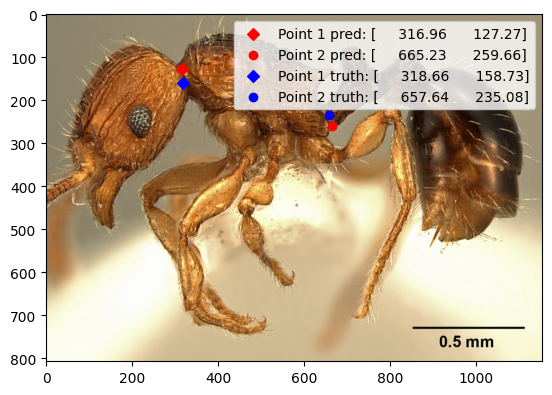


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096081_p_1.jpg: 448x640 1 thorax, 249.7ms
Speed: 15.1ms preprocess, 249.7ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)


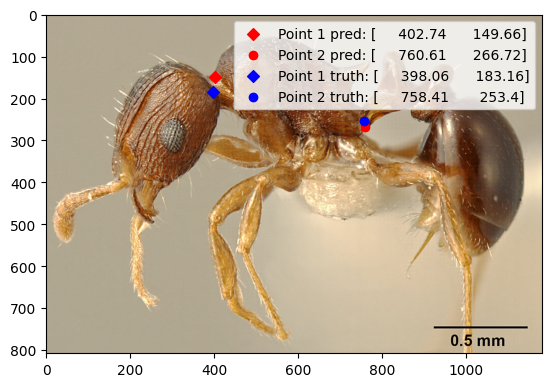


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096087_p_1.jpg: 512x640 1 thorax, 218.9ms
Speed: 6.8ms preprocess, 218.9ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)


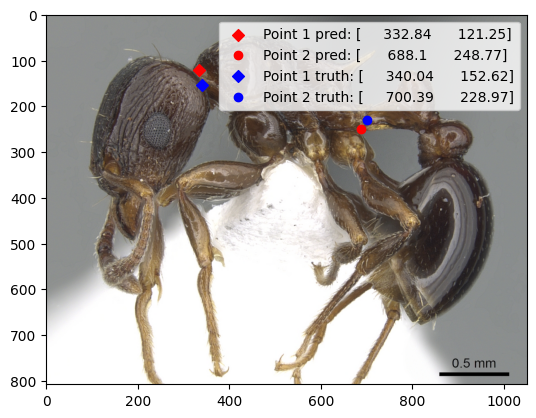


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096093_p_1.jpg: 416x640 1 thorax, 184.0ms
Speed: 1.4ms preprocess, 184.0ms inference, 0.3ms postprocess per image at shape (1, 3, 416, 640)


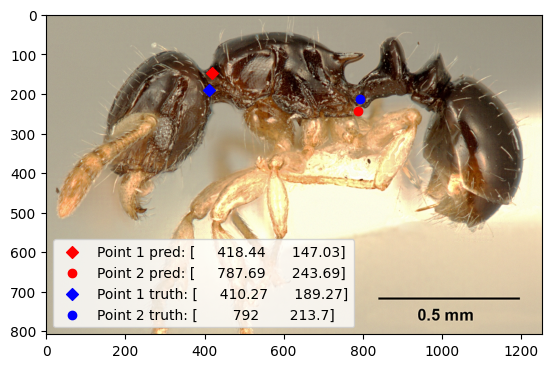


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096098_p_1.jpg: 480x640 1 thorax, 183.4ms
Speed: 1.6ms preprocess, 183.4ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


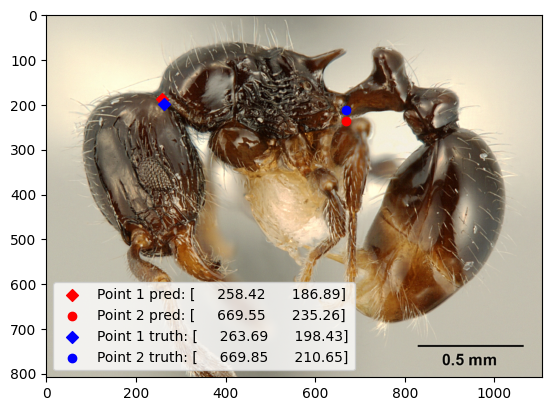


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096125_p_1.jpg: 480x640 1 thorax, 210.2ms
Speed: 1.7ms preprocess, 210.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


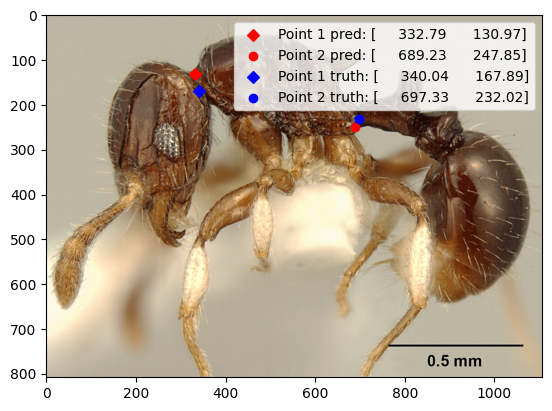


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096155_p_1.jpg: 448x640 1 thorax, 114.5ms
Speed: 21.2ms preprocess, 114.5ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)


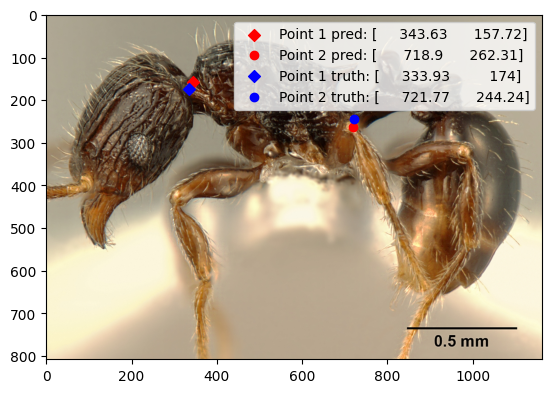


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096175_p_1.jpg: 448x640 1 thorax, 200.6ms
Speed: 1.6ms preprocess, 200.6ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)


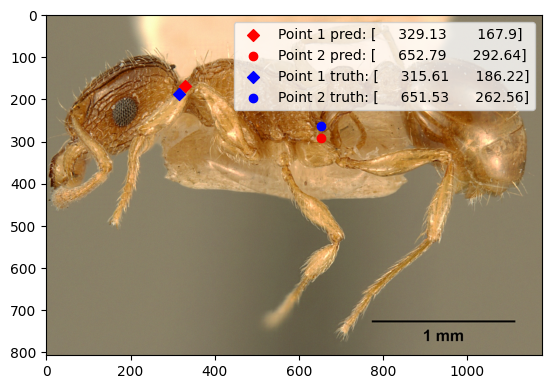


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096178_p_1.jpg: 448x640 1 thorax, 155.5ms
Speed: 1.5ms preprocess, 155.5ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)


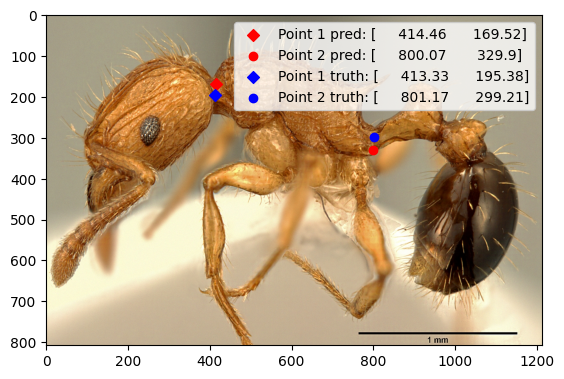


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zfmkhym20096209_p_1.jpg: 416x640 1 thorax, 188.6ms
Speed: 1.7ms preprocess, 188.6ms inference, 0.4ms postprocess per image at shape (1, 3, 416, 640)


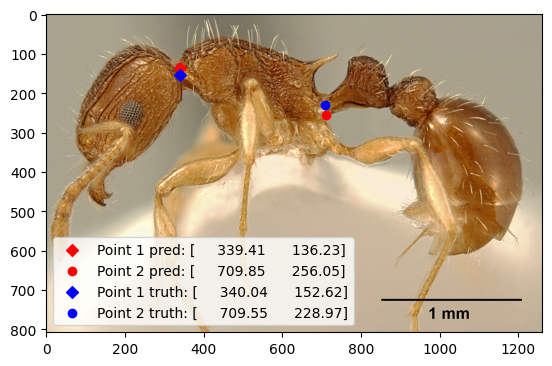


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045098_p_1.jpg: 384x640 1 thorax, 154.2ms
Speed: 1.9ms preprocess, 154.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)


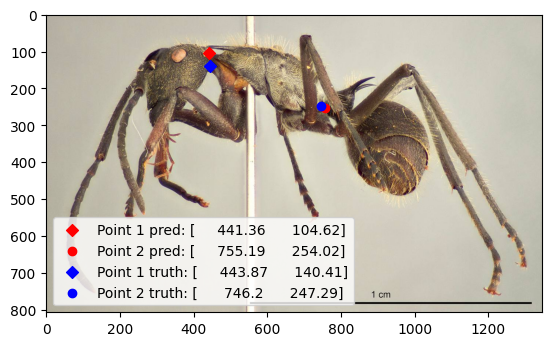


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045103_p_1.jpg: 448x640 1 thorax, 199.8ms
Speed: 1.7ms preprocess, 199.8ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)


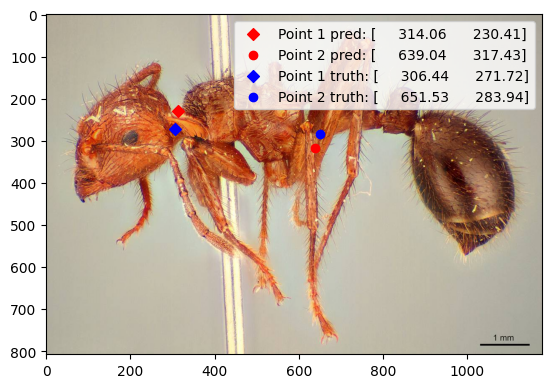


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045105_p_1.jpg: 352x640 1 thorax, 141.4ms
Speed: 1.3ms preprocess, 141.4ms inference, 0.3ms postprocess per image at shape (1, 3, 352, 640)


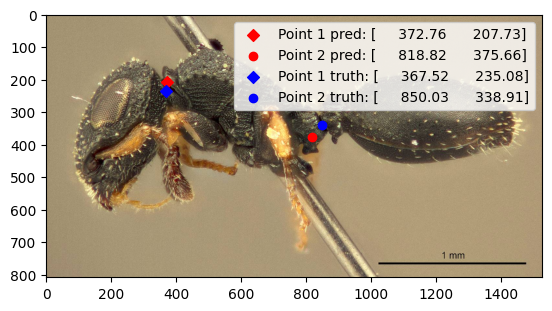


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045107_p_1.jpg: 480x640 1 thorax, 177.3ms
Speed: 1.5ms preprocess, 177.3ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


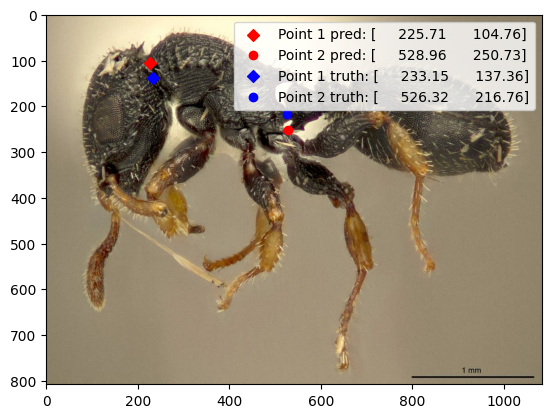


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045112_p_1.jpg: 352x640 1 thorax, 156.6ms
Speed: 1.6ms preprocess, 156.6ms inference, 0.3ms postprocess per image at shape (1, 3, 352, 640)


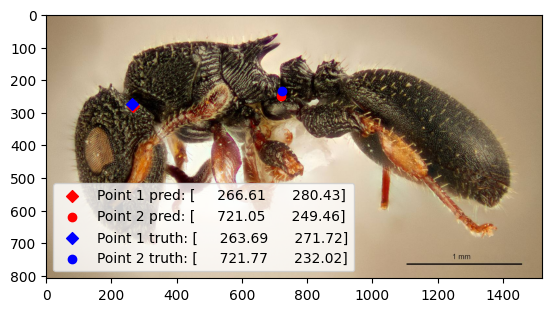


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045118_p_1.jpg: 480x640 1 thorax, 197.5ms
Speed: 1.5ms preprocess, 197.5ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


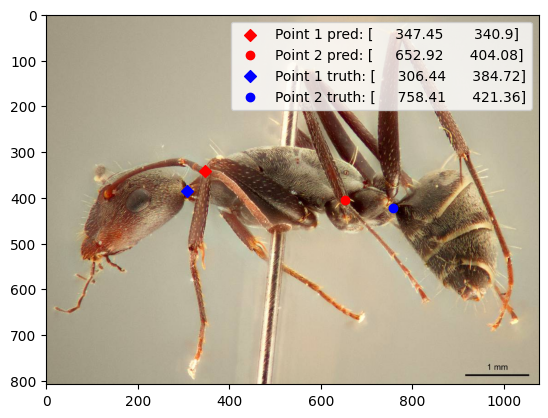


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045124_p_1.jpg: 224x640 1 thorax, 133.1ms
Speed: 0.9ms preprocess, 133.1ms inference, 0.3ms postprocess per image at shape (1, 3, 224, 640)


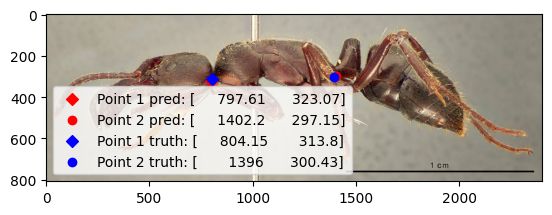


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045125_p_1.jpg: 608x640 1 thorax, 227.1ms
Speed: 1.7ms preprocess, 227.1ms inference, 0.4ms postprocess per image at shape (1, 3, 608, 640)


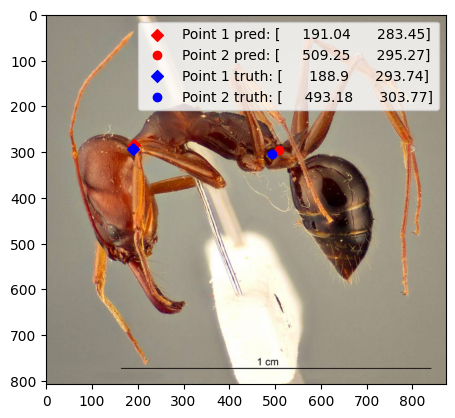


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00045129_p_1.jpg: 320x640 2 thoraxs, 169.6ms
Speed: 1.2ms preprocess, 169.6ms inference, 0.4ms postprocess per image at shape (1, 3, 320, 640)


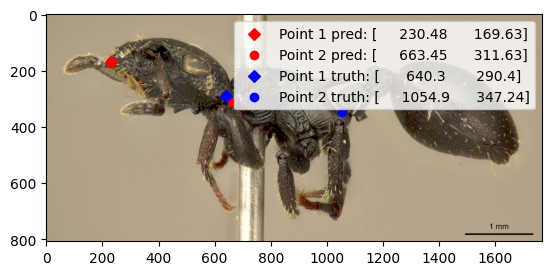


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zmuc00514656_p_1.jpg: 416x640 2 thoraxs, 181.4ms
Speed: 2.0ms preprocess, 181.4ms inference, 0.3ms postprocess per image at shape (1, 3, 416, 640)


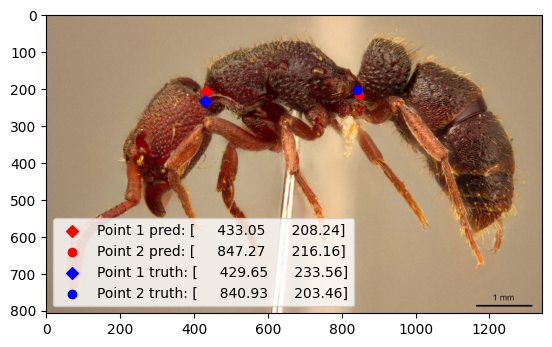


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_6_1520_p_1.jpg: 480x640 1 thorax, 171.5ms
Speed: 1.6ms preprocess, 171.5ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


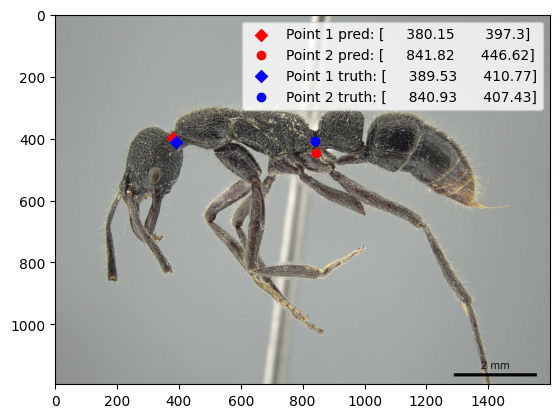


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00000092_p_1.jpg: 480x640 1 thorax, 197.6ms
Speed: 1.7ms preprocess, 197.6ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


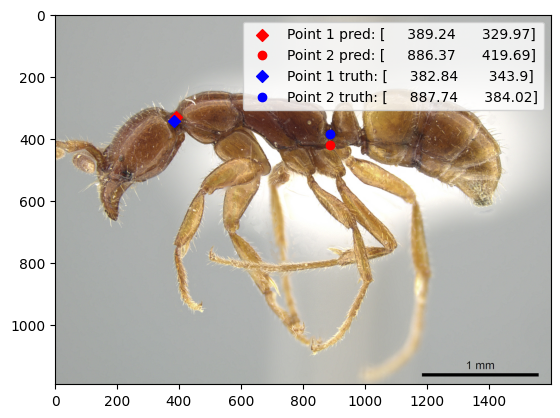


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00000950_p_1.jpg: 480x640 1 thorax, 189.9ms
Speed: 1.9ms preprocess, 189.9ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


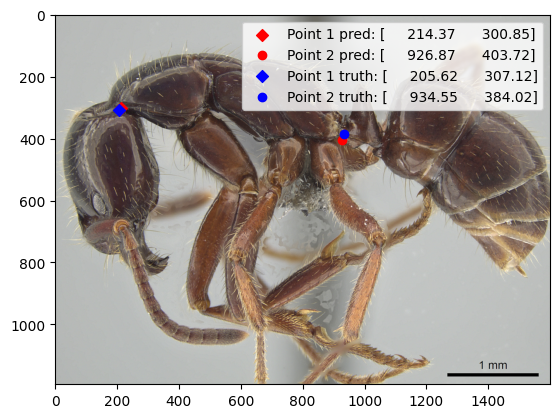


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00007359_p_1.jpg: 480x640 1 thorax, 208.4ms
Speed: 1.9ms preprocess, 208.4ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


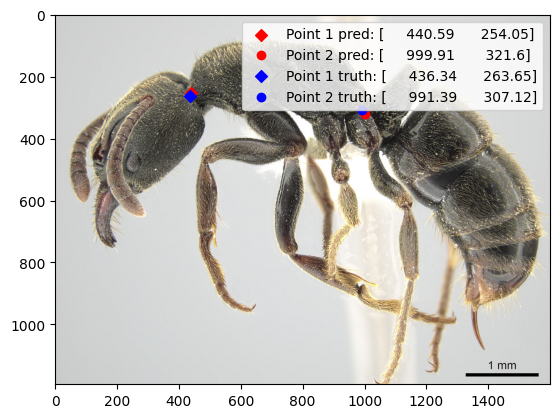


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00007921_p_1.jpg: 480x640 1 thorax, 187.6ms
Speed: 1.7ms preprocess, 187.6ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


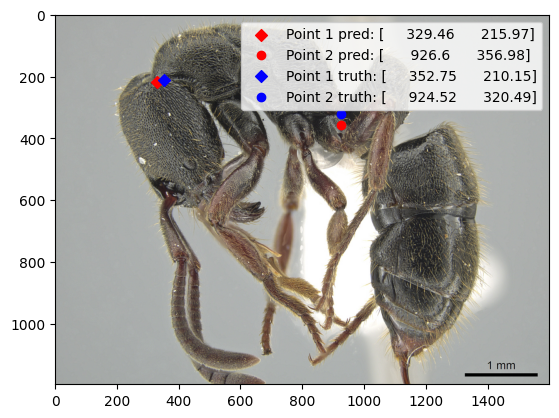


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00027944_p_1.jpg: 480x640 1 thorax, 228.1ms
Speed: 1.8ms preprocess, 228.1ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


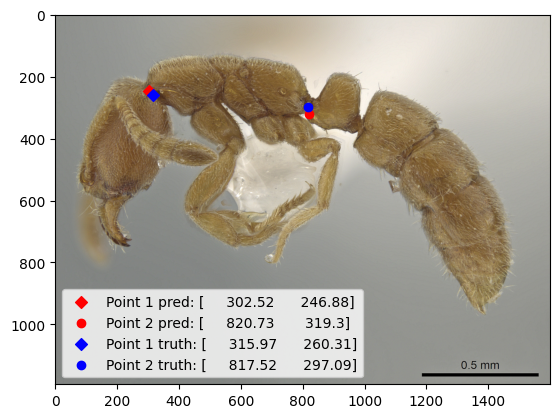


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00027958_p_1.jpg: 480x640 1 thorax, 203.8ms
Speed: 1.9ms preprocess, 203.8ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


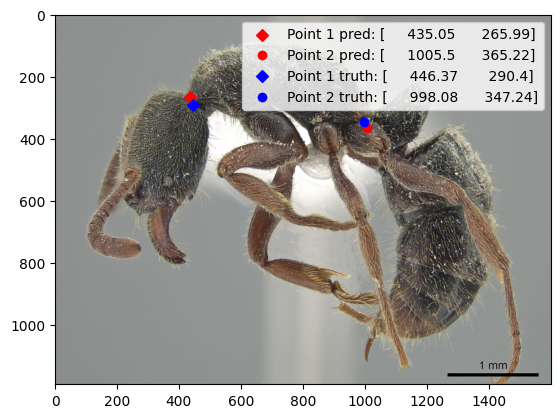


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00028293_p_1.jpg: 480x640 1 thorax, 187.3ms
Speed: 1.8ms preprocess, 187.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


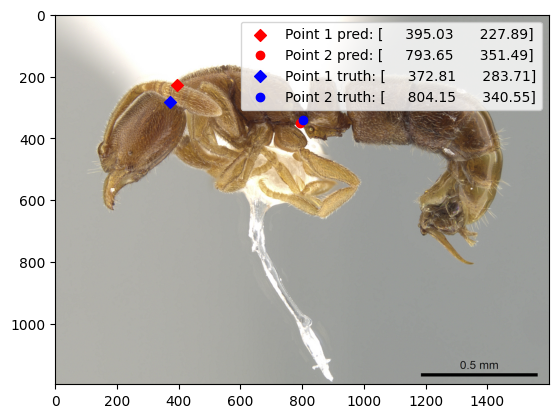


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00047820_p_1.jpg: 480x640 1 thorax, 170.3ms
Speed: 1.8ms preprocess, 170.3ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


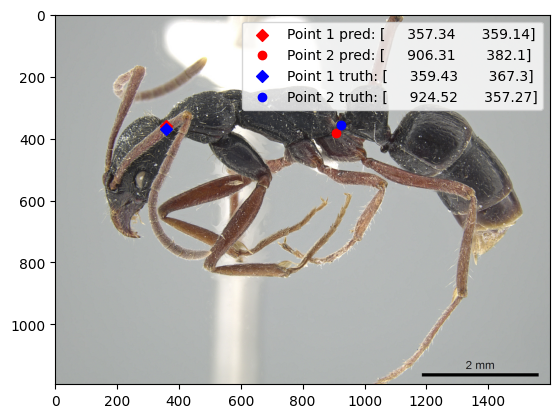


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_ent00047849_p_1.jpg: 480x640 1 thorax, 146.6ms
Speed: 9.2ms preprocess, 146.6ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


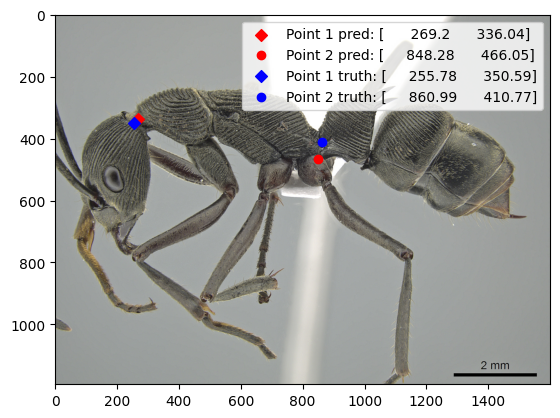


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_hym_0000493_p_1.jpg: 480x640 1 thorax, 185.9ms
Speed: 1.8ms preprocess, 185.9ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


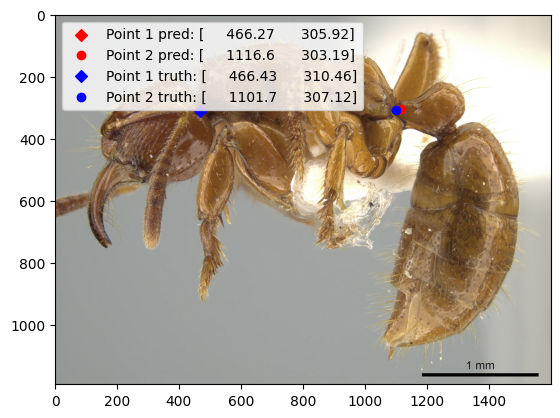


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zrc_hym_0000557_p_1.jpg: 480x640 1 thorax, 167.4ms
Speed: 1.8ms preprocess, 167.4ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


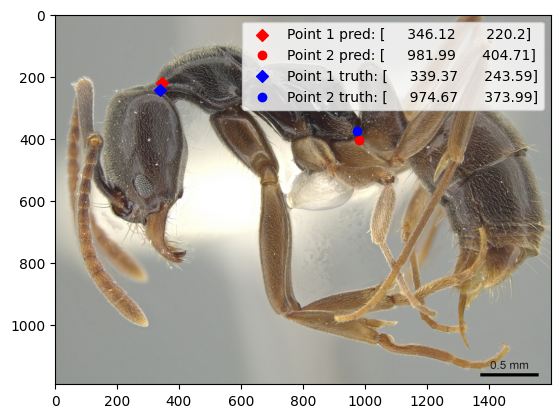


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zsmhym25181_p_1.jpg: 320x640 (no detections), 167.5ms
Speed: 1.2ms preprocess, 167.5ms inference, 0.3ms postprocess per image at shape (1, 3, 320, 640)


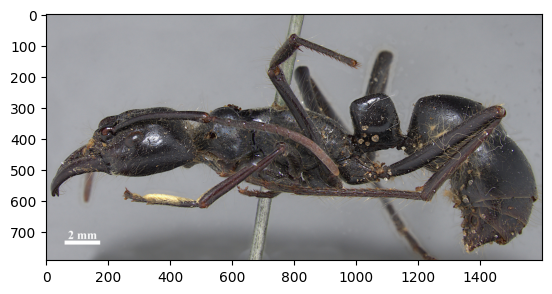


image 1/1 /Users/vivien.gaillet/Library/CloudStorage/OneDrive-NordAngliaEducation/CS_433_Machine_Learning/validation_set_Vivien/zsmhym25183_p_1.jpg: 416x640 1 thorax, 115.2ms
Speed: 3.9ms preprocess, 115.2ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)


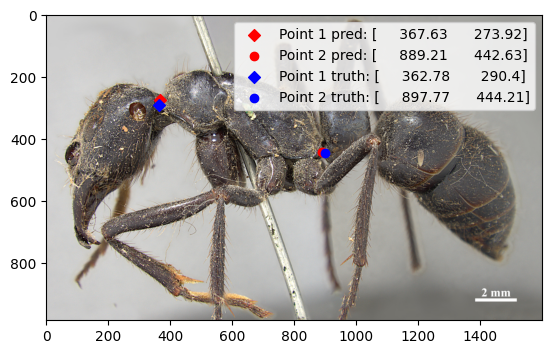

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

count = 0
for file_name in image_file_names:
    path = validation_set_images_path+file_name

    results = model.predict(path)
    shape = results[0].keypoints.shape
    
    img = mpimg.imread(path)

    plt.imshow(img)
    plt.axis('on')  # Turn on axes for reference

    if is_detected_data[count] == 1: 
        point1_pred = prediction_data[count,0:2]
        point2_pred = prediction_data[count,2:]

        point1_ground_thruth = ground_thruth_data[count,0:2]
        point2_ground_thruth = ground_thruth_data[count,2:]

        # Plot the points

        plt.scatter(*point1_pred, color='red', marker='D',label=f'Point 1 pred: {point1_pred}')
        plt.scatter(*point2_pred, color='red', label=f'Point 2 pred: {point2_pred}')

        plt.scatter(*point1_ground_thruth, color='blue', marker='D',label=f'Point 1 truth: {point1_ground_thruth}')
        plt.scatter(*point2_ground_thruth, color='blue', label=f'Point 2 truth: {point2_ground_thruth}')

        # Add legend
        plt.legend()

        # Show the plot
    plt.show()
    count = count + 1
